# NIST-1411 (glass sample)

This notebook contains the results for the dataset NIST-1411:

### Chapters:
 - Baseline Regression
 - Baseline Simulation

#### Raw Data Directory

In [3]:
sdir = r'..\data\raw data txt\NIST-1411'

#### Imports

In [1]:
import os, sys
if os.path.dirname(os.getcwd()) not in sys.path:
    sys.path.insert(0, os.path.dirname(os.getcwd())) # appends parent directory to syspath -> enables import of src
import lib.datalayers as dly
import lib.model as mod
import importlib
importlib.reload(dly)
importlib.reload(mod)

<module 'lib.model' from 'c:\\Users\\Marlene\\Nextcloud\\DOKUMENTE\\Universität\\Diplomarbeit\\lib\\model.py'>

#### Initialize dataset

In [4]:
dataset = dly.Dataset(sdir,overwrite=False)

Dataset: NIST-1411
Files of dataset loaded


## Baseline Regression

The best settings for baseline regression were:
- minima filter width = 40 nm
- detailed region for minima filter at start and end of spectrum = 20
- steps of minima filter within detailed region = 40/2/10
- minima filter in both directions = False
- endpoint weight = 1

The median common degree was 4.

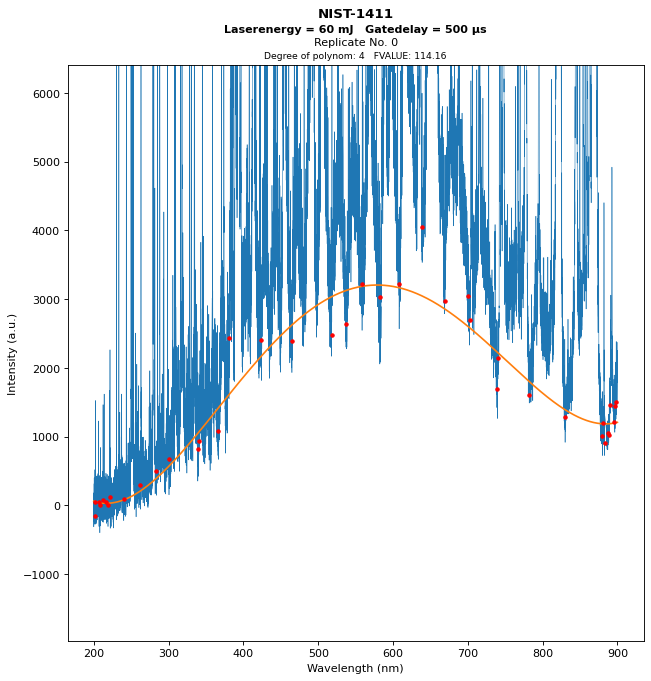

In [8]:
spectrum = dly.Spectrum(dataset, laser_energy=60, gate_delay=500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=False)
spectrum.baseline.calculate_regression(deg_min=3, endpoint_weight=1)
spectrum.plot_spectrum(view="detail", figsizex=9, figsizey=9, dpi=80)

It can be seen, that a higher endpoint weight leads to an overfit.

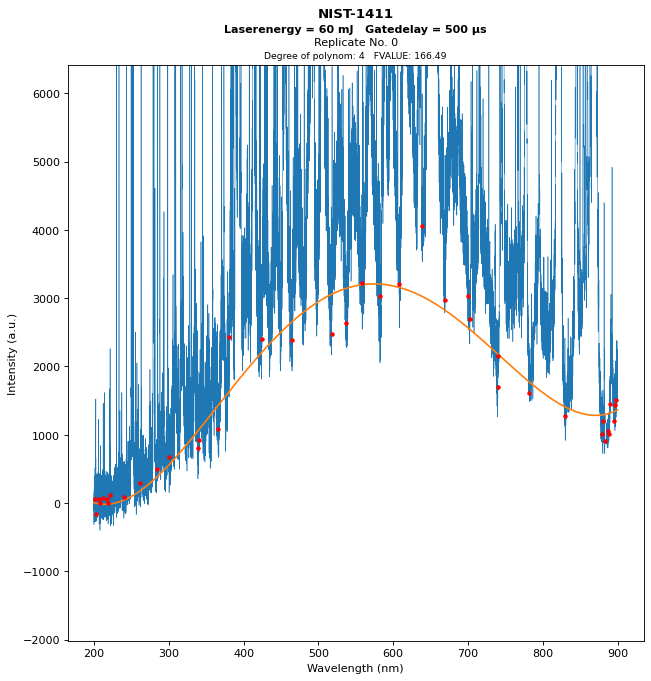

In [11]:
spectrum = dly.Spectrum(dataset, laser_energy=60, gate_delay=500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=False)
spectrum.baseline.calculate_regression(deg_min=3, endpoint_weight=1000)
spectrum.plot_spectrum(view="detail", figsizex=9, figsizey=9, dpi=80)

Running the minium filter into both directions also leads to an overfit at the upper end of the spectrum. This can be seen better if the endpoint weight is slightly boosted as well.

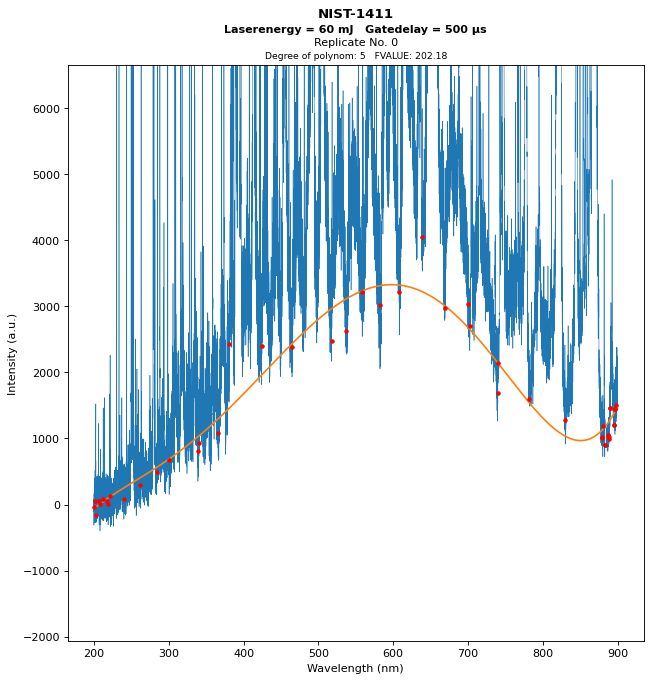

In [12]:
spectrum = dly.Spectrum(dataset, laser_energy=60, gate_delay=500, DEBUG=False, repno=0)
spectrum.cond.interpolate_dead_pixels()
spectrum.baseline.find_pivot_points(width_wvn_detail=20, detailfactor=10, reverse=True)
spectrum.baseline.calculate_regression(deg_min=3, endpoint_weight=100)
spectrum.plot_spectrum(view="detail", figsizex=9, figsizey=9, dpi=80)

Calculate plot: 100%|██████████| 64/64 [06:14<00:00,  5.85s/it]


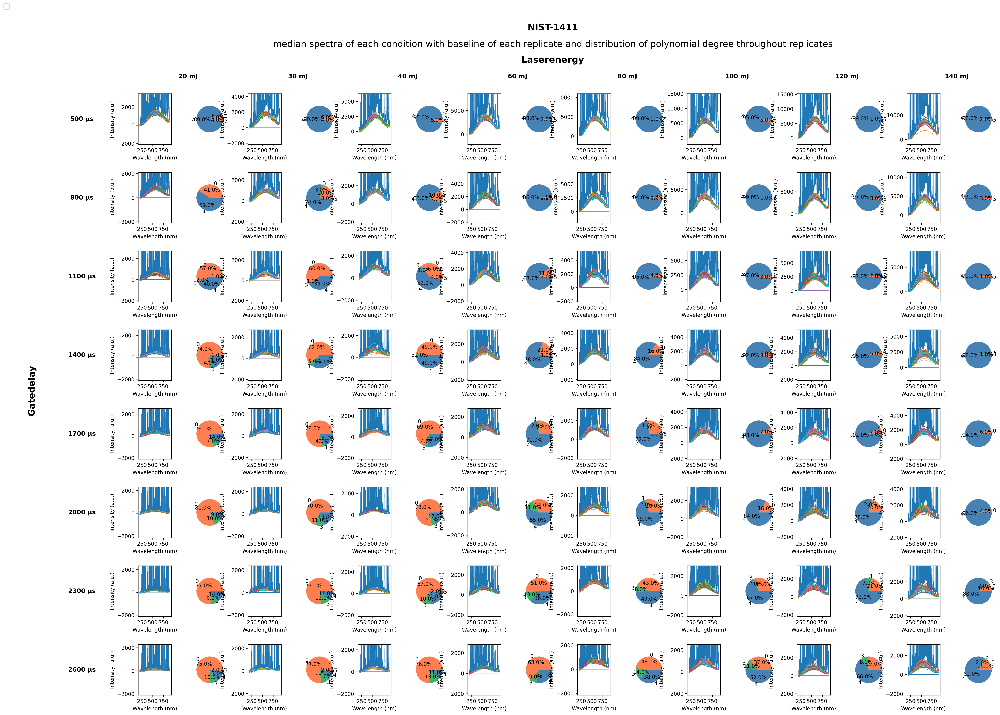

In [13]:
dataset.plot_dataset(type_list=["stability", "pie"], deg_min=3, width_wvn_detail=20, detailfactor=10, endpoint_weight=1, reverse=False)

Calculate plot: 100%|██████████| 64/64 [05:22<00:00,  5.03s/it]


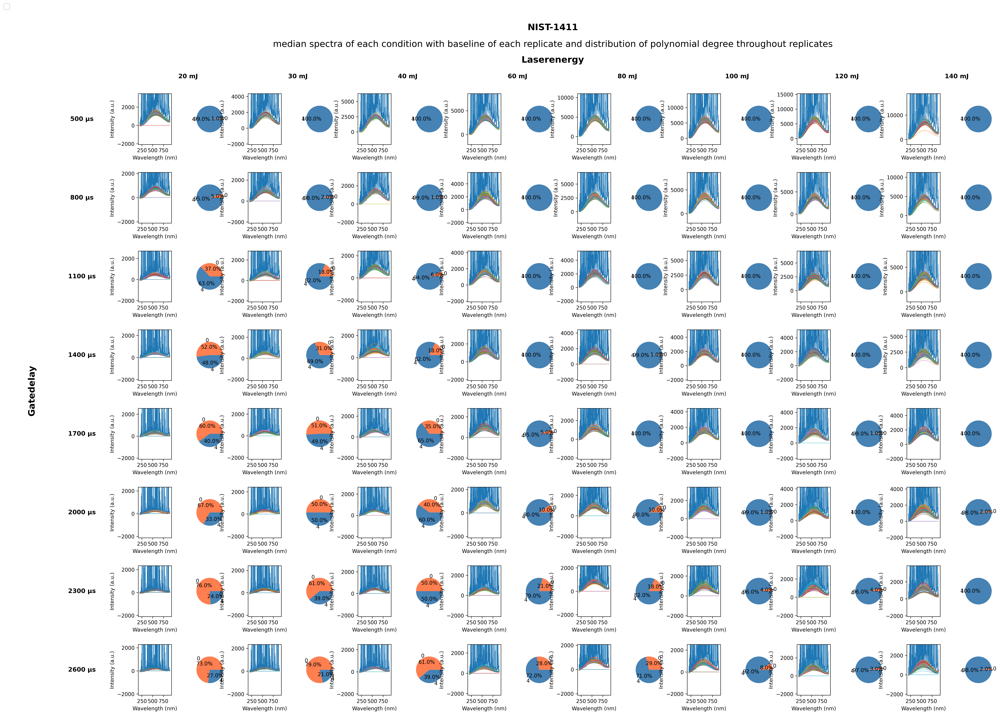

In [14]:
dataset.plot_dataset(type_list=["stability", "pie"], deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, endpoint_weight=1, reverse=False)

## Baseline Simulation

Fit model: 100%|██████████| 5/5 [00:00<00:00, 14.78it/s]


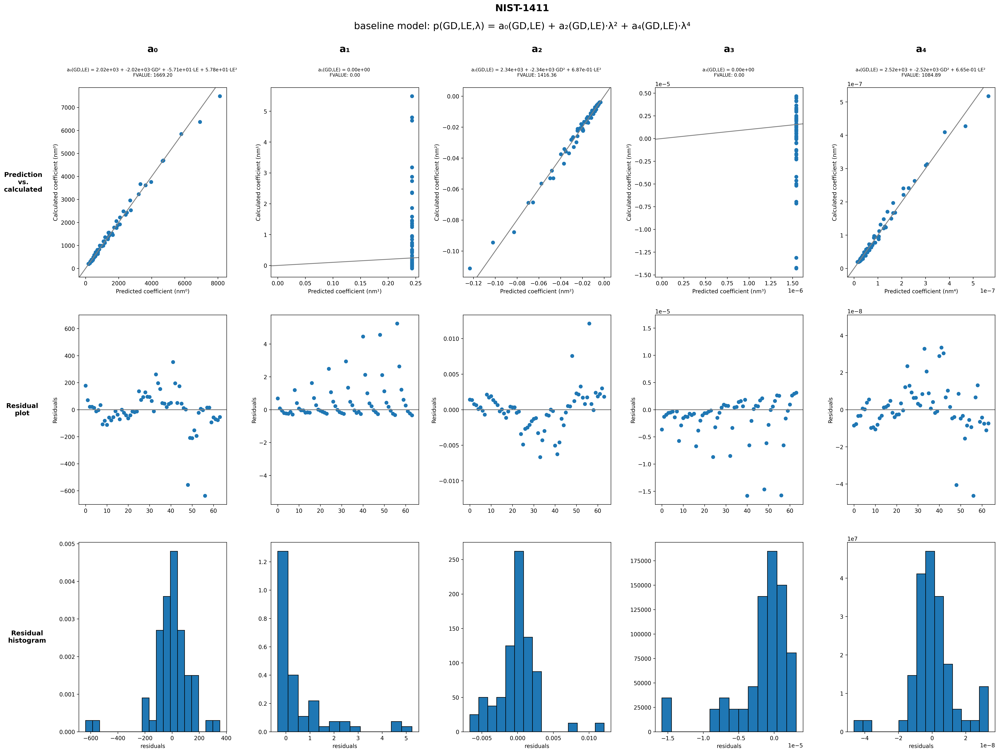

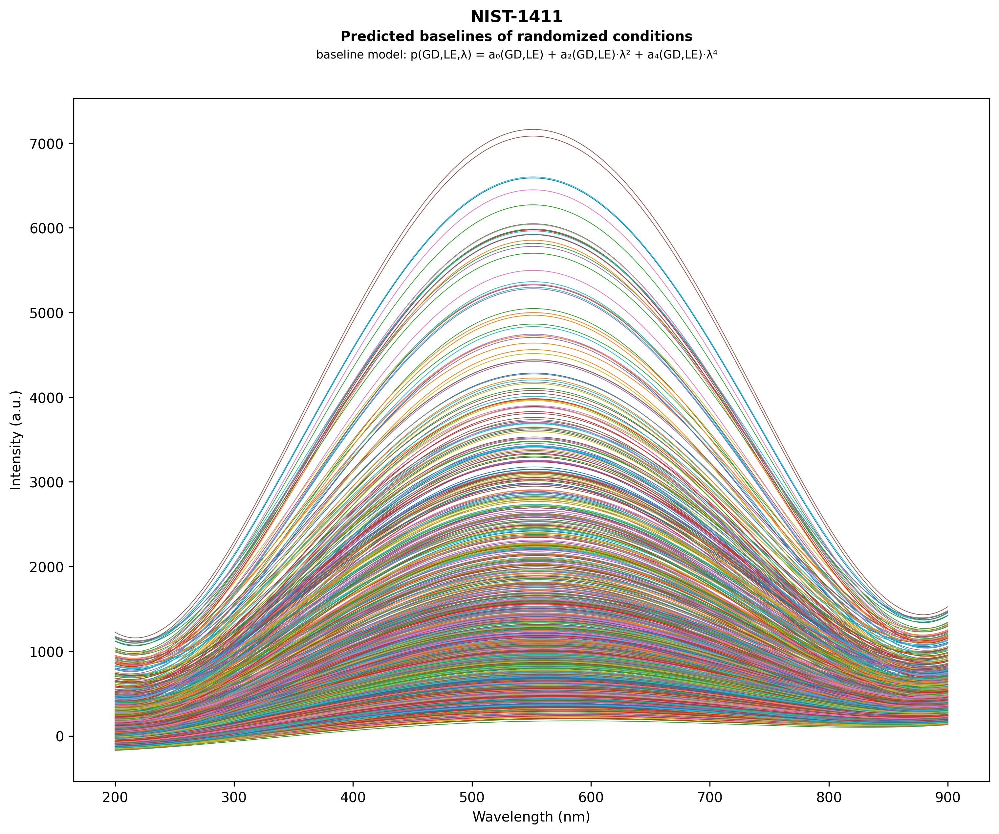

In [15]:
summary_baseline_coeff_regression, baseline_regression_settings =dataset.summarize_baseline_coefficients(deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, endpoint_weight=1, reverse=False, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
baseline.summary_coeff_models()
baseline.model_assessment_plot()
baseline.model_stabilty_plot(dataset.wavelength_range)

For two baseline coefficients, no model with significant coefficients could be fitted.
The simulated baselines fit very well to the calculated baselines.

Calculate plot: 100%|██████████| 64/64 [04:21<00:00,  4.09s/it]


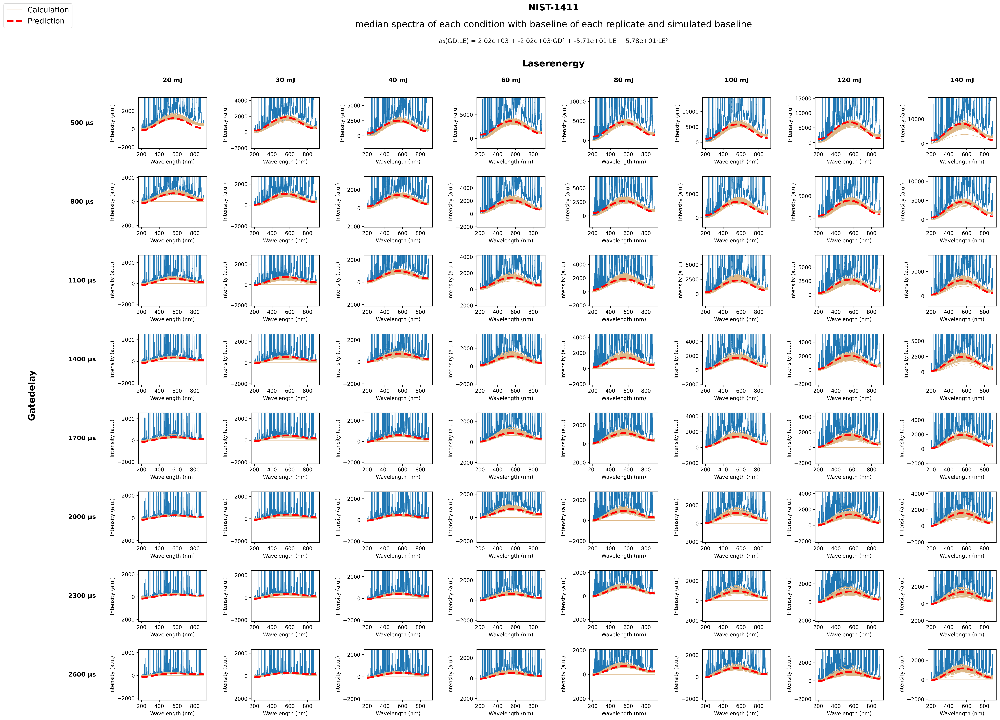

In [16]:
dataset.plot_dataset(type_list=["stability"], baseline_regression=True, baseline_model=baseline_model,deg_min=4, deg_max=4, width_wvn_detail=20, detailfactor=10, endpoint_weight=1, reverse=False)